# Results for TSMCN-8-L-229 with SNR=inf. Noise added test data is analyzed after experimental classification

RSAT=0.01 and 90 spectra per class

In [1]:
%matplotlib inline 
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from matplotlib.ticker import MaxNLocator
import numpy as np
from numpy import asarray
import pandas as pd
import math
import seaborn as sns  #heat map
import glob # batch processing of images


import matplotlib.font_manager as fm
import random
import sys
import os

from sklearn.datasets import make_regression
import tensorflow as tf
from sklearn.metrics import confusion_matrix    #confusion matrix
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

# Collect all the font names available to matplotlib
font_names = [f.name for f in fm.fontManager.ttflist]
# print(font_names)

from scipy import signal
from scipy import interpolate

from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import roc_curve 
from sklearn.metrics import auc
from sklearn.metrics import roc_auc_score


from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import DotProduct, WhiteKernel
from sklearn.gaussian_process.kernels import RBF

#Sklearn model saving and loading
from joblib import dump, load

if '../../' not in sys.path:
    sys.path.append('../../')

from aimos.spectral_datasets.THz_datasets import THz_data

from aimos.misc.utils import simple_plotter


#Set random seed
os.environ['PYTHONHASHSEED'] = str(42)
os.environ['TF_DETERMINISTIC_OPS'] = '1'
tf.random.set_global_generator(42)

tf.random.set_seed(42)  
# tf.random.get_global_generator().reset_from_seed(42)
np.random.seed(42)
random.seed(42)

from oneida import THz_mixture_data
from oneida_utils import concentrations_to_one_hot_encode, create_mixture_names
from oneida_utils import simple_spectrum_fig, simple_plot_raw_scores, plot_spectrum_with_scores, multiclass_roc_auc_score, multiclass_sensitivity_specificity_score, multiclass_sensitivity_threshold_score
from oneida_scoring_tools import calc_AMCAS, is_cui_present, is_cui_present_in_mult
from aimos.misc.utils import classifier_internals
from aimos.misc.utils import clf_post_processor
from oneida_utils import mixture_names_to_one_hot_encode
from sklearn.metrics import multilabel_confusion_matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from oneida_grad_cam import grad_cam

from stats import stats
stats(n_compounds=8)

2022-11-07 23:28:56.473774: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-11-07 23:28:58.562836: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2022-11-07 23:28:59.461325: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib/cuda/include:/usr/lib/cuda/lib64:
2022-11-07 23:28:59.461375: I tensorflow/stream_execu

Total 1-C combinations: 8
Total 2-C combinations: 28
Total 3-C combinations: 56
Total 4-C combinations: 70
Total 5-C combinations: 56
Total 6-C combinations: 28
Total 7-C combinations: 8
Total 8-C combinations: 1
Total combinations: 255


# Retrieve training(D)+ validation(V) mixtures and its variables

In [2]:
# initialize
TAAT = 0.001 
ASAT=0.01
RSAT=0.01

m = THz_mixture_data(resolution=0.016, pressure='1 Torr', verbosity=False)
m.initiate_THz_mixture_data(TAAT = TAAT, 
                               ASAT=ASAT, 
                               RSAT=RSAT)

reduced_labels = m.labels
reduced_labels.remove('')
reduced_labels.remove(' ')
reduced_labels.remove('Diluent')
print('reduced_labels', reduced_labels)


# data_filename = "datasets/TSMCN-5-L-229_DV_04-09-2022_time_22-26-37.pkl"
data_filename = "datasets/TSMCN-8-L-229_DV__TAAT_0.001_ASAT_0.01_RSAT_0.01_20-10-2022_time_23-16-29_class_cnt_90.pkl"
DV = pd.read_pickle(data_filename)
y = DV['y'].to_numpy()
mixture_names = DV['mixture_names'].to_numpy()
y_concentrations = DV[['y_c0', 'y_c1', 'y_c2','y_c3', 'y_c4', 'y_c5', 'y_c6', 'y_c7']].to_numpy()
X = DV.drop(['y','mixture_names', 'y_c0', 'y_c1', 'y_c2','y_c3', 'y_c4', 'y_c5', 'y_c6', 'y_c7'],axis=1).to_numpy()

final_neuron_number = np.unique(y, axis=0).shape[0]
print('Number of neurons in the final layer :', final_neuron_number)

print('labels from class:', m.labels)

Components :  [[0 1 2 3 4 5 6 7 8]]
Components shape :  (1, 9)
TAAT =  0.001
ASAT =  0.01
RSAT =  0.01
reduced_labels ['$C_2H_5OH$', '$CH_3CHO$', '$CH_3Cl$', '$CH_3CN$', '$CH_3OH$', '$H_2CO$', '$HCOOH$', '$HNO_3$']
Number of neurons in the final layer : 255
labels from class: ['$C_2H_5OH$', '$CH_3CHO$', '$CH_3Cl$', '$CH_3CN$', '$CH_3OH$', '$H_2CO$', '$HCOOH$', '$HNO_3$']


# preview one test mixture spectra using simple plotter

In [3]:
# idx = 239
# simple_plotter(m.frequencies,X[idx],linewidth=0.5,color='black',label=mixture_names[idx], 
#                    majorsize=6,minorsize=2,width=1, labelsize=8,legendsize=3, legendloc=2,  
#                    labelpad=4,fontsize='medium',fontweight='bold',
#                   xmajormplloc=0.5,xminormplloc=0.2, tickdirection='out')

# print(y_concentrations[idx])
# print(reduced_labels)

In [4]:
from sklearn import preprocessing

le = preprocessing.LabelEncoder()
le.fit(mixture_names)

mixture_types=le.classes_
print(mixture_types)

['$CH_3CHO$' '$CH_3CHO$+$CH_3CN$' '$CH_3CHO$+$CH_3CN$+$CH_3OH$'
 '$CH_3CHO$+$CH_3CN$+$CH_3OH$+$HCOOH$'
 '$CH_3CHO$+$CH_3CN$+$CH_3OH$+$HCOOH$+$HNO_3$'
 '$CH_3CHO$+$CH_3CN$+$CH_3OH$+$HNO_3$'
 '$CH_3CHO$+$CH_3CN$+$CH_3OH$+$H_2CO$'
 '$CH_3CHO$+$CH_3CN$+$CH_3OH$+$H_2CO$+$HCOOH$'
 '$CH_3CHO$+$CH_3CN$+$CH_3OH$+$H_2CO$+$HCOOH$+$HNO_3$'
 '$CH_3CHO$+$CH_3CN$+$CH_3OH$+$H_2CO$+$HNO_3$'
 '$CH_3CHO$+$CH_3CN$+$HCOOH$' '$CH_3CHO$+$CH_3CN$+$HCOOH$+$HNO_3$'
 '$CH_3CHO$+$CH_3CN$+$HNO_3$' '$CH_3CHO$+$CH_3CN$+$H_2CO$'
 '$CH_3CHO$+$CH_3CN$+$H_2CO$+$HCOOH$'
 '$CH_3CHO$+$CH_3CN$+$H_2CO$+$HCOOH$+$HNO_3$'
 '$CH_3CHO$+$CH_3CN$+$H_2CO$+$HNO_3$' '$CH_3CHO$+$CH_3Cl$'
 '$CH_3CHO$+$CH_3Cl$+$CH_3CN$' '$CH_3CHO$+$CH_3Cl$+$CH_3CN$+$CH_3OH$'
 '$CH_3CHO$+$CH_3Cl$+$CH_3CN$+$CH_3OH$+$HCOOH$'
 '$CH_3CHO$+$CH_3Cl$+$CH_3CN$+$CH_3OH$+$HCOOH$+$HNO_3$'
 '$CH_3CHO$+$CH_3Cl$+$CH_3CN$+$CH_3OH$+$HNO_3$'
 '$CH_3CHO$+$CH_3Cl$+$CH_3CN$+$CH_3OH$+$H_2CO$'
 '$CH_3CHO$+$CH_3Cl$+$CH_3CN$+$CH_3OH$+$H_2CO$+$HCOOH$'
 '$CH_3CHO$+$CH_3Cl$+$CH_3CN

In [5]:
#split intro train and validation set

#seeds used 123,237, 786
from sklearn.model_selection import train_test_split

global_indices=range(0, X.shape[0])
print(global_indices)

# (np.expand_dims(X,-1)
TRAIN_SIZE=0.60
VAL_SIZE=1-TRAIN_SIZE

x_train, x_val, y_train, y_val, train_indices, val_indices = train_test_split(np.expand_dims(X, axis=-1), y, global_indices, train_size=TRAIN_SIZE,
                                                   test_size=VAL_SIZE,
                                                   random_state=786,
                                                    stratify=y

                                                   )

print('X_train shape:', x_train.shape)
print('y_ohe_train shape:', y_train.shape)

print('X_val shape:', x_val.shape)
print('y_ohe_val shape:', y_val.shape)


print("All:", np.bincount(y) / float(len(y))*100  )
print("Training:", np.bincount(y_train) / float(len(y_train))*100  )
print("Validation:", np.bincount(y_val) / float(len(y_val))*100  )


range(0, 22950)
X_train shape: (13770, 229, 1)
y_ohe_train shape: (13770,)
X_val shape: (9180, 229, 1)
y_ohe_val shape: (9180,)
All: [0.39215686 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686
 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686
 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686
 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686
 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686
 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686
 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686
 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686
 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686
 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686
 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686
 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686
 0.39215686 0.39215686 0.39215686 0.39215686 0.39215686 0.39215

In [6]:
from oneida_model import get_callbacks, get_optimizer, compile_and_fit, TSMCN_12_L_229,  TSMCN_12_L_229_w_dropout

In [7]:
# model = TSMCN_12_L_229_w_dropout()
model = TSMCN_12_L_229()

2022-11-07 23:31:59.370662: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib/cuda/include:/usr/lib/cuda/lib64:
2022-11-07 23:31:59.370811: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublas.so.11'; dlerror: libcublas.so.11: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib/cuda/include:/usr/lib/cuda/lib64:
2022-11-07 23:31:59.370901: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublasLt.so.11'; dlerror: libcublasLt.so.11: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib/cuda/include:/usr/lib/cuda/lib64:
2022-11-07 23:31:59.518856: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuso

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 C1 (Conv1D)                 (None, 227, 3)            12        
                                                                 
 S2 (AveragePooling1D)       (None, 113, 3)            0         
                                                                 
 C3 (Conv1D)                 (None, 111, 3)            30        
                                                                 
 S4 (AveragePooling1D)       (None, 55, 3)             0         
                                                                 
 C5 (Conv1D)                 (None, 53, 3)             30        
                                                                 
 flatten (Flatten)           (None, 159)               0         
                                                                 
 dense (Dense)               (None, 275)               4

In [8]:
# tf.keras.utils.plot_model(model, to_file="RESULTS/TSMCN_8_L_229.png", show_shapes=True, rankdir='TB', dpi=150)

In [9]:
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath='checkpoints/',
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

model_name = data_filename.split('.pkl')[0].split('/')[1]
print(model_name)

TSMCN-8-L-229_DV__TAAT_0.001_ASAT_0.01_RSAT_0.01_20-10-2022_time_23-16-29_class_cnt_90


In [17]:
# run on CPU for reproducibility, best epoch is 4.
# with tf.device('/CPU:0'):
#      stop_early = tf.keras.callbacks.EarlyStopping(monitor='SparseCatCrossentropy', patience=5)
#     history = model.fit(x_train, y_train, epochs=20, validation_data=(x_test, y_test), callbacks=[stop_early])

# LambdaCallback(on_epoch_end=lambda batch, logs: print(model.layers[0].get_weights()))
with tf.device('/CPU:0'):
    stop_early = tf.keras.callbacks.EarlyStopping(monitor='SparseCatCrossentropy', patience=5)
    history = model.fit(x_train, y_train, batch_size=32, epochs=30, validation_data=(x_val, y_val), 
                        callbacks=[model_checkpoint_callback, stop_early],
)



Epoch 1/30
431/431 [==============================] - 5s 10ms/step - loss: 3.5902 - SparseCatCrossentropy: 3.5880 - accuracy: 0.1279 - val_loss: 1.9684 - val_SparseCatCrossentropy: 1.9684 - val_accuracy: 0.3577
Epoch 2/30
431/431 [==============================] - 4s 8ms/step - loss: 1.2309 - SparseCatCrossentropy: 1.2299 - accuracy: 0.5730 - val_loss: 0.8607 - val_SparseCatCrossentropy: 0.8606 - val_accuracy: 0.6833
Epoch 3/30
431/431 [==============================] - 4s 9ms/step - loss: 0.5666 - SparseCatCrossentropy: 0.5662 - accuracy: 0.8085 - val_loss: 0.6709 - val_SparseCatCrossentropy: 0.6708 - val_accuracy: 0.7895
Epoch 4/30
431/431 [==============================] - 4s 9ms/step - loss: 0.3566 - SparseCatCrossentropy: 0.3563 - accuracy: 0.8802 - val_loss: 0.3483 - val_SparseCatCrossentropy: 0.3482 - val_accuracy: 0.8786
Epoch 5/30
431/431 [==============================] - 4s 9ms/step - loss: 0.2984 - SparseCatCrossentropy: 0.2980 - accuracy: 0.8988 - val_loss: 0.2712 - val_Sp

In [29]:
# #Sklearn model saving and loading
# from joblib import dump, load
# import datetime
# from datetime import date, datetime
# now = datetime.now()
# dt_string = now.strftime("%d-%m-%Y_time_%H-%M-%S")
# model.save('model/' + model_name + '_' + dt_string + '.hdf5')
# np.save('model/' + model_name + '_' + dt_string + 'history' + '.npy',history.history)
# np.save('model/' + model_name + '_' + dt_string + 'epoch' + '.npy',history.epoch)


In [25]:
# model = tf.keras.models.load_model('model/' + model_name + '_' + dt_string + '.hdf5', compile=False)


In [10]:
probability_model = tf.keras.Sequential([model, 
                                         tf.keras.layers.Softmax()])
predictions = probability_model.predict(x_val)


pred_y=np.argmax(model.predict(x_val), axis=-1)

287/287 [==============================] - 1s 3ms/step


In [11]:
y_ohe = concentrations_to_one_hot_encode(y_concentrations).astype('int64')
y_train_ohe = y_ohe[train_indices]
y_val_ohe = y_ohe[val_indices]
y_train_ohe_tensor = tf.convert_to_tensor(y_train_ohe, np.int64)
y_val_ohe_tensor = tf.convert_to_tensor(y_val_ohe, np.int64)

In [12]:
plt.figure(dpi=150)
plt.scatter(history.epoch,history.history['accuracy'], color = 'red', label = 'training')
plt.scatter(history.epoch,history.history['val_accuracy'], color = 'blue', label = 'validation')
plt.legend(loc=4)
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
# plt.savefig(r'RESULTS/results_figures/' + model_name + '_accuracies.png', bbox_inches='tight')

plt.figure(dpi=150)
plt.scatter(history.epoch,history.history['SparseCatCrossentropy'], color = 'red', label = 'training')
plt.scatter(history.epoch,history.history['val_SparseCatCrossentropy'],color = 'blue', label = 'validation')
plt.legend(loc=1)
plt.xlabel('Epoch')
plt.ylabel('Sparse categorical crossentropy loss')
# plt.savefig(r'RESULTS/results_figures/'+ model_name + '_sparse_cat_losses.png', bbox_inches='tight')

NameError: name 'history' is not defined

<Figure size 900x600 with 0 Axes>

Text(0, 0.5, 'Sparse categorical crossentropy loss')

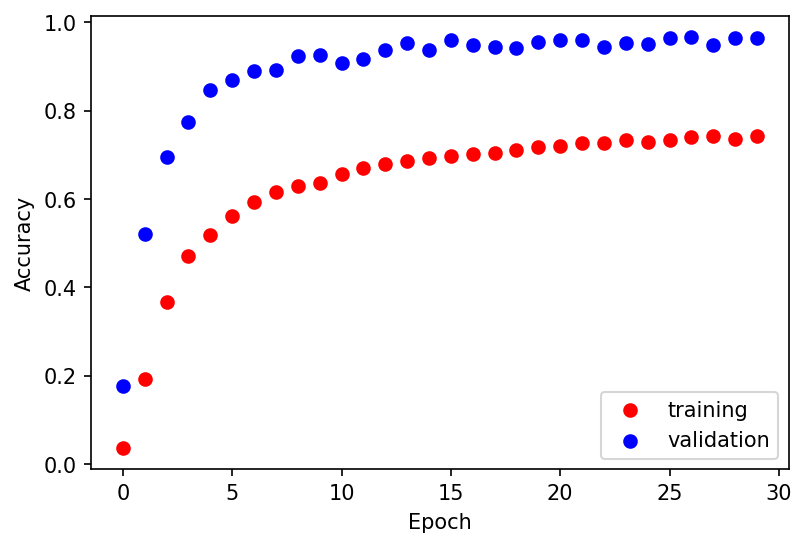

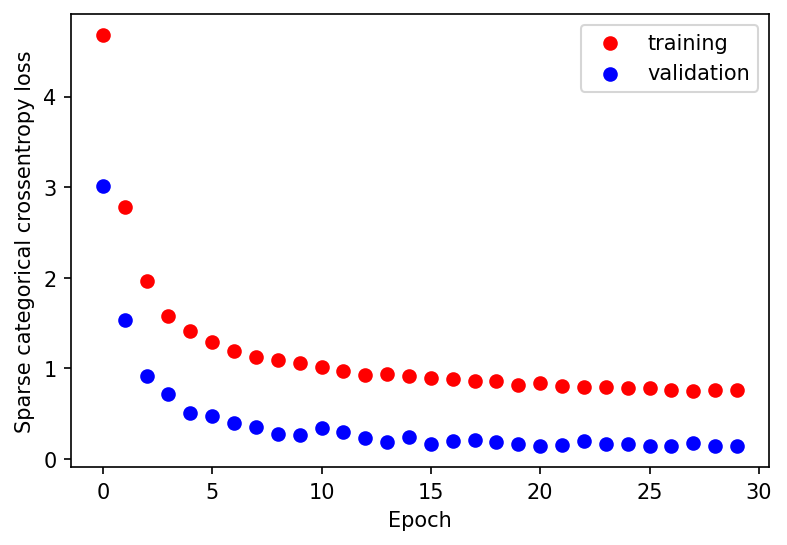

In [13]:
plt.figure(dpi=150)
plt.scatter(history.epoch,history.history['accuracy'], color = 'red', label = 'training')
plt.scatter(history.epoch,history.history['val_accuracy'], color = 'blue', label = 'validation')
plt.legend(loc=4)
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
# plt.savefig(r'RESULTS/results_figures/' + model_name + '_accuracies.png', bbox_inches='tight')

plt.figure(dpi=150)
plt.scatter(history.epoch,history.history['SparseCatCrossentropy'], color = 'red', label = 'training')
plt.scatter(history.epoch,history.history['val_SparseCatCrossentropy'],color = 'blue', label = 'validation')
plt.legend(loc=1)
plt.xlabel('Epoch')
plt.ylabel('Sparse categorical crossentropy loss')
# plt.savefig(r'RESULTS/results_figures/'+ model_name + '_sparse_cat_losses.png', bbox_inches='tight')

In [21]:


exps = ['2 Comp-mix_ 30 % CH3Cl - 70% CH3CN/Mix 50% Dilute CM-ACN.xlsx',
'2 Comp-mix_ 30 % CH3Cl - 70% CH3CN/Pure Mix CM-ACN.xlsx',
'2 Comp-mix_ 30 % CH3Cl - 70% CH3CN/Mix 90% Dilute CM-ACN.xlsx',
'3 Comp-mix_ 90+% CH3OH + 5-% CH3CN + 5-% CH3CL/0.9 CH3OH + 0.05 CH3CN + 0.05 CH3Cl - 1.xlsx',
'3 Comp-mix_ 90+% CH3OH + 5-% CH3CN + 5-% CH3CL/0.9 CH3OH + 0.05 CH3CN + 0.05 CH3Cl - 2.xlsx',
'4 Comp-mix_ 67% CH3OH + 30% CH3CHO + 2% CH3Cl + 1% CH3CN/0.67 CH3OH + 0.3 CH3CHO + 0.02 CH3Cl + 0.01 CH3CN - v2.xlsx',
'4 Comp-mix_ 67% CH3OH + 30% CH3CHO + 2% CH3Cl + 1% CH3CN/90% Dilute in N2 - 0.67 CH3OH + 0.3 CH3CHO + 0.02 CH3Cl + 0.01 CH3CN.xlsx'       ]

true_label=[81,81,81,82,82,19,19]

exp_path = '../../data/Mixture_exp_data/'
exp_filepath = '4 Comp-mix_ 67% CH3OH + 30% CH3CHO + 2% CH3Cl + 1% CH3CN/0.67 CH3OH + 0.3 CH3CHO + 0.02 CH3Cl + 0.01 CH3CN - v2.xlsx'


def classify_exp(exp_path,exp_filepath,mixture_types,true_label, excel=True):
    all_unique_labels= mixture_types
    if excel:
        df_exp1 = pd.read_excel(exp_path + exp_filepath)
    else:
        df_exp1 = pd.read_csv(exp_path + exp_filepath)


    freq_exp1 = df_exp1[df_exp1.columns[0]].to_numpy()
    abs_exp1 = df_exp1[df_exp1.columns[1]].to_numpy()
    
#     fft_filter(freq_exp1, abs_exp1, factor=75)

    dfy_resampled= signal.resample(abs_exp1, len(m.frequencies))
    dfx_resampled= signal.resample(freq_exp1, len(m.frequencies))
    expanded_abs = np.expand_dims(np.expand_dims(dfy_resampled, axis=-1), axis=0)
    pred_exp_label = np.argmax(model.predict(expanded_abs), axis=-1)[0]
    
    score_predictions = probability_model.predict(expanded_abs)
    scoreDf = pd.DataFrame()
    scoreDf['mixture_type'] = mixture_types
#     import pdb; pdb.set_trace()
    scoreDf['softmax'] = score_predictions[0]
#     scoreDf.to_csv(r'RESULTS/exp_preds/' + 'exp' + str(idx) + '.csv')
    
    sorted_scoresDf = scoreDf.sort_values(by='softmax', ascending=False).head(n=5)
    
#     print(score_predictions)
    print('Experiment name: ',exp_filepath.split('/')[0])
    print('File name: ',exp_filepath.split('/')[1])
    print('predicted index ', pred_exp_label)
    print('predicted label', mixture_types[pred_exp_label])
#     display(sorted_scoresDf)
    print('-----------------------------------------------------')


#     import pdb; pdb.set_trace()
    return pred_exp_label, sorted_scoresDf
idx = 0 
for experiment in exps:
    pred_exp_label, sorted_scoresDf = classify_exp(exp_path,experiment,mixture_types, true_label[idx],excel=True)
    idx+=1
    sorted_scoresDf.index.name = 'label'
#     df_styled = sorted_scoresDf.style.background_gradient()
#     dfi.export(df_styled,"result_df_" + str(idx) + ".png")
#     dfi.export(sorted_scoresDf,"result_df_" + str(idx) + ".png")

1/1 [==============================] - 0s 22ms/step
Experiment name:  2 Comp-mix_ 30 % CH3Cl - 70% CH3CN
File name:  Mix 50% Dilute CM-ACN.xlsx
predicted index  202
predicted label $C_2H_5OH$+$CH_3Cl$+$CH_3CN$
-----------------------------------------------------
1/1 [==============================] - 0s 22ms/step
Experiment name:  2 Comp-mix_ 30 % CH3Cl - 70% CH3CN
File name:  Pure Mix CM-ACN.xlsx
predicted index  203
predicted label $C_2H_5OH$+$CH_3Cl$+$CH_3CN$+$CH_3OH$
-----------------------------------------------------
1/1 [==============================] - 0s 24ms/step
Experiment name:  2 Comp-mix_ 30 % CH3Cl - 70% CH3CN
File name:  Mix 90% Dilute CM-ACN.xlsx
predicted index  202
predicted label $C_2H_5OH$+$CH_3Cl$+$CH_3CN$
-----------------------------------------------------
1/1 [==============================] - 0s 27ms/step
Experiment name:  3 Comp-mix_ 90+% CH3OH + 5-% CH3CN + 5-% CH3CL
File name:  0.9 CH3OH + 0.05 CH3CN + 0.05 CH3Cl - 1.xlsx
predicted index  82
predicted l

In [22]:


exps = ['1 comp/v2Paper Ethanol 1 Torr.csv',
       '1 comp/Methanol 1 Torr WDL 8.csv',
       '1 comp/Formic Acid 1 Torr WDL 5 Notch Shift.csv',
       '1 comp/Acetaldehyde 1 Torr WDL 6 Notch.csv',
       '1 comp/Acetaldehyde 0p5 Torr WDL 5.csv',
       '1 comp/1-Sweep v2 CH3OH 220-330-1 Torr.csv',
       '1 comp/1-Sweep CH3Cl 220-330-1 Torr.csv',
       '1 comp/1-Sweep CH3Cl 220-330-0p5 Torr.csv',
       '1 comp/1-Sweep 0p5 Torr-CH3CN.csv',]
true_label=[120,112,248,0,0,80,80,64]

exp_path = '../../data/Mixture_exp_data/'
exp_filepath = '4 Comp-mix_ 67% CH3OH + 30% CH3CHO + 2% CH3Cl + 1% CH3CN/0.67 CH3OH + 0.3 CH3CHO + 0.02 CH3Cl + 0.01 CH3CN - v2.xlsx'


def classify_exp(exp_path,exp_filepath,mixture_types,true_label, excel=True):
    all_unique_labels= mixture_types
    if excel:
        df_exp1 = pd.read_excel(exp_path + exp_filepath)
    else:
        df_exp1 = pd.read_csv(exp_path + exp_filepath)


    freq_exp1 = df_exp1[df_exp1.columns[0]].to_numpy()
    abs_exp1 = df_exp1[df_exp1.columns[1]].to_numpy()
    
#     fft_filter(freq_exp1, abs_exp1, factor=75)

    dfy_resampled= signal.resample(abs_exp1, len(m.frequencies))
    dfx_resampled= signal.resample(freq_exp1, len(m.frequencies))
    expanded_abs = np.expand_dims(np.expand_dims(dfy_resampled, axis=-1), axis=0)
    pred_exp_label = np.argmax(model.predict(expanded_abs), axis=-1)[0]
    
    score_predictions = probability_model.predict(expanded_abs)
    scoreDf = pd.DataFrame()
    scoreDf['mixture_type'] = mixture_types
#     import pdb; pdb.set_trace()
    scoreDf['softmax'] = score_predictions[0]
#     scoreDf.to_csv(r'RESULTS/exp_preds/' + 'exp' + str(idx) + '.csv')
    
    sorted_scoresDf = scoreDf.sort_values(by='softmax', ascending=False).head(n=10)
    
#     print(score_predictions)
    print('Experiment name: ',exp_filepath.split('/')[0])
    print('File name: ',exp_filepath.split('/')[1])
    print('predicted index ', pred_exp_label)
    print('predicted label', mixture_types[pred_exp_label])
    display(sorted_scoresDf)
    print('-----------------------------------------------------')
    
    

    return pred_exp_label
idx = 0 
for experiment in exps:
    classify_exp(exp_path,experiment,mixture_types, true_label[0],excel=False)
    idx+=1

1/1 [==============================] - 0s 28ms/step
Experiment name:  1 comp
File name:  v2Paper Ethanol 1 Torr.csv
predicted index  120
predicted label $C_2H_5OH$


,mixture_type,softmax
120,$C_2H_5OH$,0.953077
244,$C_2H_5OH$+$H_2CO$,0.042517
247,$C_2H_5OH$+$H_2CO$+$HNO_3$,0.003001
251,$H_2CO$,0.001137
185,$C_2H_5OH$+$CH_3CN$,0.000169
246,$C_2H_5OH$+$H_2CO$+$HCOOH$+$HNO_3$,0.000038
197,$C_2H_5OH$+$CH_3CN$+$H_2CO$,0.000016
76,$CH_3CN$+$H_2CO$,0.000012
233,$C_2H_5OH$+$CH_3OH$,0.000008
64,$CH_3CN$,0.000006


-----------------------------------------------------
1/1 [==============================] - 0s 24ms/step
Experiment name:  1 comp
File name:  Methanol 1 Torr WDL 8.csv
predicted index  112
predicted label $CH_3OH$


,mixture_type,softmax
112,$CH_3OH$,9.999921e-01
116,$CH_3OH$+$H_2CO$,7.707147e-06
65,$CH_3CN$+$CH_3OH$,7.355727e-08
113,$CH_3OH$+$HCOOH$,6.809591e-09
69,$CH_3CN$+$CH_3OH$+$H_2CO$,8.748588e-10
233,$C_2H_5OH$+$CH_3OH$,7.731768e-11
97,$CH_3Cl$+$CH_3OH$,3.689081e-12
49,$CH_3CHO$+$CH_3OH$,2.413763e-12
53,$CH_3CHO$+$CH_3OH$+$H_2CO$,5.626955e-13
5,$CH_3CHO$+$CH_3CN$+$CH_3OH$+$HNO_3$,1.444647e-13


-----------------------------------------------------
1/1 [==============================] - 0s 22ms/step
Experiment name:  1 comp
File name:  Formic Acid 1 Torr WDL 5 Notch Shift.csv
predicted index  248
predicted label $HCOOH$


,mixture_type,softmax
248,$HCOOH$,1.000000e+00
252,$H_2CO$+$HCOOH$,6.316635e-09
90,$CH_3Cl$+$CH_3CN$+$HCOOH$,4.863349e-09
113,$CH_3OH$+$HCOOH$,6.509660e-11
73,$CH_3CN$+$HCOOH$,5.015809e-11
249,$HCOOH$+$HNO_3$,3.741763e-12
105,$CH_3Cl$+$HCOOH$,1.303425e-12
57,$CH_3CHO$+$HCOOH$,6.821795e-14
77,$CH_3CN$+$H_2CO$+$HCOOH$,5.588854e-14
241,$C_2H_5OH$+$HCOOH$,3.424827e-14


-----------------------------------------------------
1/1 [==============================] - 0s 28ms/step
Experiment name:  1 comp
File name:  Acetaldehyde 1 Torr WDL 6 Notch.csv
predicted index  180
predicted label $C_2H_5OH$+$CH_3CHO$+$HNO_3$


,mixture_type,softmax
180,$C_2H_5OH$+$CH_3CHO$+$HNO_3$,9.970815e-01
184,$C_2H_5OH$+$CH_3CHO$+$H_2CO$+$HNO_3$,2.918304e-03
137,$C_2H_5OH$+$CH_3CHO$+$CH_3CN$+$H_2CO$+$HNO_3$,1.308683e-07
52,$CH_3CHO$+$CH_3OH$+$HNO_3$,6.527085e-08
59,$CH_3CHO$+$HNO_3$,1.077475e-08
179,$C_2H_5OH$+$CH_3CHO$+$HCOOH$+$HNO_3$,2.921330e-09
121,$C_2H_5OH$+$CH_3CHO$,6.621131e-10
130,$C_2H_5OH$+$CH_3CHO$+$CH_3CN$+$CH_3OH$+$H_2CO$...,6.305745e-10
247,$C_2H_5OH$+$H_2CO$+$HNO_3$,3.690716e-10
133,$C_2H_5OH$+$CH_3CHO$+$CH_3CN$+$HNO_3$,8.288172e-11


-----------------------------------------------------
1/1 [==============================] - 0s 26ms/step
Experiment name:  1 comp
File name:  Acetaldehyde 0p5 Torr WDL 5.csv
predicted index  180
predicted label $C_2H_5OH$+$CH_3CHO$+$HNO_3$


,mixture_type,softmax
180,$C_2H_5OH$+$CH_3CHO$+$HNO_3$,0.922872
5,$CH_3CHO$+$CH_3CN$+$CH_3OH$+$HNO_3$,0.029677
52,$CH_3CHO$+$CH_3OH$+$HNO_3$,0.013932
12,$CH_3CHO$+$CH_3CN$+$HNO_3$,0.012611
121,$C_2H_5OH$+$CH_3CHO$,0.008502
133,$C_2H_5OH$+$CH_3CHO$+$CH_3CN$+$HNO_3$,0.006690
130,$C_2H_5OH$+$CH_3CHO$+$CH_3CN$+$CH_3OH$+$H_2CO$...,0.001908
126,$C_2H_5OH$+$CH_3CHO$+$CH_3CN$+$CH_3OH$+$HNO_3$,0.001706
173,$C_2H_5OH$+$CH_3CHO$+$CH_3OH$+$HNO_3$,0.001292
49,$CH_3CHO$+$CH_3OH$,0.000577


-----------------------------------------------------
1/1 [==============================] - 0s 41ms/step
Experiment name:  1 comp
File name:  1-Sweep v2 CH3OH 220-330-1 Torr.csv
predicted index  112
predicted label $CH_3OH$


,mixture_type,softmax
112,$CH_3OH$,9.998423e-01
69,$CH_3CN$+$CH_3OH$+$H_2CO$,1.098065e-04
65,$CH_3CN$+$CH_3OH$,4.774224e-05
116,$CH_3OH$+$H_2CO$,9.880018e-08
113,$CH_3OH$+$HCOOH$,1.639608e-12
190,$C_2H_5OH$+$CH_3CN$+$CH_3OH$+$H_2CO$,7.768155e-14
64,$CH_3CN$,8.654069e-16
233,$C_2H_5OH$+$CH_3OH$,3.025928e-16
6,$CH_3CHO$+$CH_3CN$+$CH_3OH$+$H_2CO$,1.785316e-16
9,$CH_3CHO$+$CH_3CN$+$CH_3OH$+$H_2CO$+$HNO_3$,2.969279e-17


-----------------------------------------------------
1/1 [==============================] - 0s 21ms/step
Experiment name:  1 comp
File name:  1-Sweep CH3Cl 220-330-1 Torr.csv
predicted index  81
predicted label $CH_3Cl$+$CH_3CN$


,mixture_type,softmax
81,$CH_3Cl$+$CH_3CN$,9.999777e-01
82,$CH_3Cl$+$CH_3CN$+$CH_3OH$,2.212613e-05
97,$CH_3Cl$+$CH_3OH$,5.959433e-08
80,$CH_3Cl$,4.998734e-08
92,$CH_3Cl$+$CH_3CN$+$HNO_3$,4.419098e-08
22,$CH_3CHO$+$CH_3Cl$+$CH_3CN$+$CH_3OH$+$HNO_3$,1.659832e-08
64,$CH_3CN$,4.233361e-10
18,$CH_3CHO$+$CH_3Cl$+$CH_3CN$,1.467801e-10
85,$CH_3Cl$+$CH_3CN$+$CH_3OH$+$HNO_3$,1.309075e-10
19,$CH_3CHO$+$CH_3Cl$+$CH_3CN$+$CH_3OH$,1.576177e-11


-----------------------------------------------------
1/1 [==============================] - 0s 23ms/step
Experiment name:  1 comp
File name:  1-Sweep CH3Cl 220-330-0p5 Torr.csv
predicted index  81
predicted label $CH_3Cl$+$CH_3CN$


,mixture_type,softmax
81,$CH_3Cl$+$CH_3CN$,9.984060e-01
82,$CH_3Cl$+$CH_3CN$+$CH_3OH$,1.561598e-03
90,$CH_3Cl$+$CH_3CN$+$HCOOH$,1.710542e-05
97,$CH_3Cl$+$CH_3OH$,1.402398e-05
80,$CH_3Cl$,1.171105e-06
18,$CH_3CHO$+$CH_3Cl$+$CH_3CN$,4.831911e-08
92,$CH_3Cl$+$CH_3CN$+$HNO_3$,2.043685e-09
86,$CH_3Cl$+$CH_3CN$+$CH_3OH$+$H_2CO$,5.787205e-10
83,$CH_3Cl$+$CH_3CN$+$CH_3OH$+$HCOOH$,1.935028e-10
202,$C_2H_5OH$+$CH_3Cl$+$CH_3CN$,1.763598e-10


-----------------------------------------------------
1/1 [==============================] - 0s 22ms/step
Experiment name:  1 comp
File name:  1-Sweep 0p5 Torr-CH3CN.csv
predicted index  185
predicted label $C_2H_5OH$+$CH_3CN$


,mixture_type,softmax
185,$C_2H_5OH$+$CH_3CN$,5.672221e-01
64,$CH_3CN$,4.325123e-01
186,$C_2H_5OH$+$CH_3CN$+$CH_3OH$,2.655469e-04
65,$CH_3CN$+$CH_3OH$,4.074540e-10
202,$C_2H_5OH$+$CH_3Cl$+$CH_3CN$,1.437886e-10
203,$C_2H_5OH$+$CH_3Cl$+$CH_3CN$+$CH_3OH$,1.271592e-14
196,$C_2H_5OH$+$CH_3CN$+$HNO_3$,1.414645e-15
120,$C_2H_5OH$,1.834664e-16
76,$CH_3CN$+$H_2CO$,4.510089e-17
189,$C_2H_5OH$+$CH_3CN$+$CH_3OH$+$HNO_3$,3.033318e-17


-----------------------------------------------------


layer C5 class activation maps


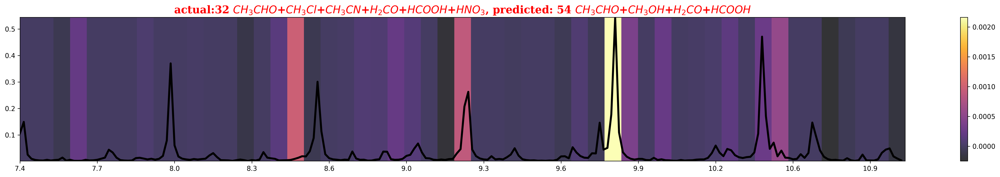

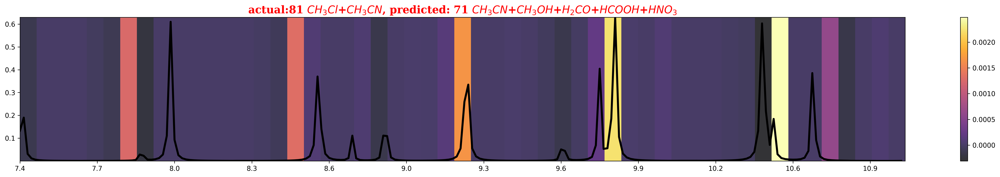

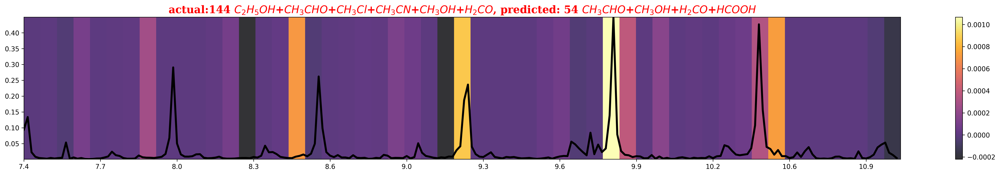

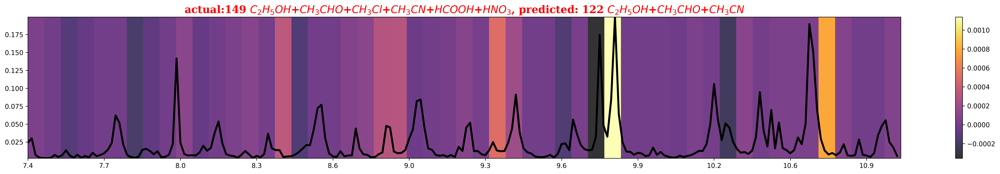

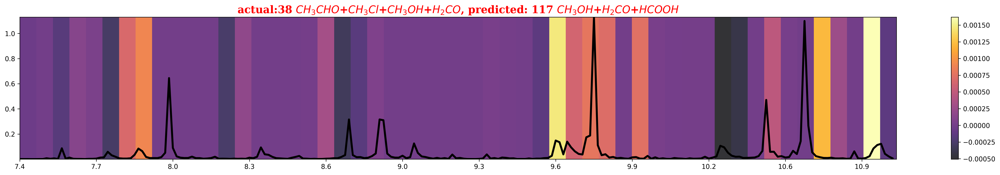

...

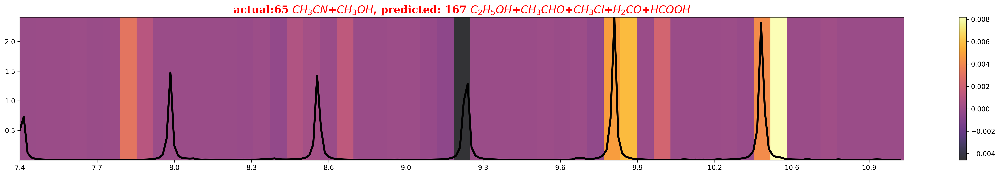

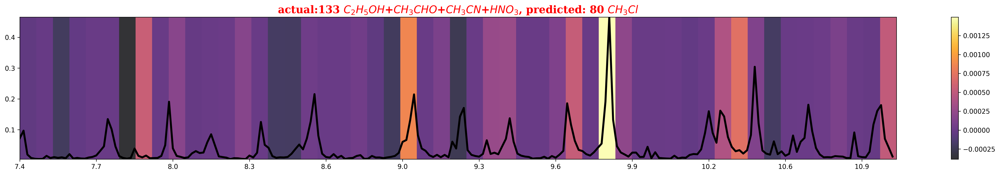

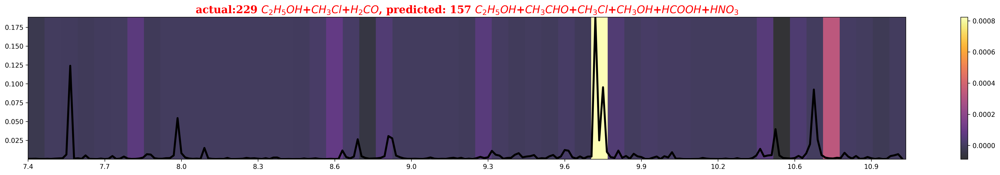

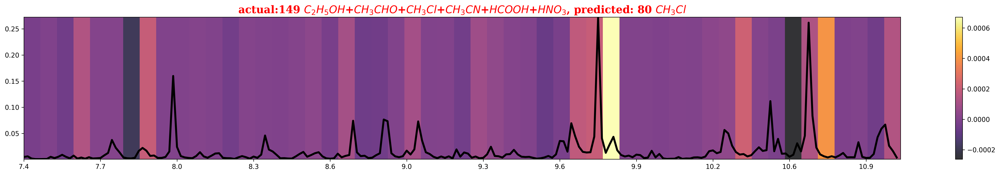

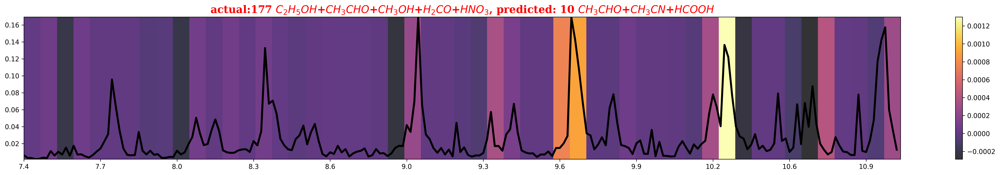

KeyboardInterrupt: 

In [13]:
layer_name = 'C5'
#calculate max heatmap value to normalize the plots
max_heat_map_vals=[]
min_heat_map_vals=[]
# for i in x_val:
    
#     data = np.expand_dims(i,0)
#     heatmap = grad_cam(layer_name,data, model)
#     max_heat_map_vals.append(np.max(heatmap))
#     min_heat_map_vals.append(np.min(heatmap))

print(f'layer {layer_name} class activation maps')

font = {'family': 'serif',
        'color':  'black',
        'weight': 'bold',
        'size': 16,
        }

# freq_GHz = 29.9792458*m.frequencies
freq_GHz = m.frequencies

count = 0





for i,j,k in zip(x_val,y_val,pred_y):
    
    data = np.expand_dims(i,0)
    heatmap = grad_cam(layer_name,data, model)
    
#     norm_heat_map = (heatmap-min(min_heat_map_vals))/(max(max_heat_map_vals)-min(min_heat_map_vals)) #normalize globally
    
#     norm_heat_map = (heatmap-np.min(heatmap))//(np.max(heatmap)-np.min(heatmap)) # normalzie individual heatmaps
    
    #normalized map
#     fig = plt.figure(figsize=(30,4),dpi=300)
#     plt.imshow(np.expand_dims(norm_heat_map,axis=2), aspect="auto", cmap='inferno_r', interpolation='nearest',extent=[0,229,i.min(),i.max()], alpha=0.8)
    
#     ticklist = range(0,229)
#     plt.xticks(ticklist[::30], np.round(m.frequencies.tolist()[::30], decimals=1) ) # tick every 40th frequency
#     plt.xticks(ticklist[::20], np.round(freq_GHz[::20], decimals=1) ) # tick every 40th frequency
#     plt.plot(i,'k',linewidth=3)
    
#     if mixture_types[j] != mixture_types[k]:
#         plt.title(f'actual:{mixture_types[j]}, predicted:{mixture_types[k]}', color='red', fontdict=font)
#     else:
#         plt.title(f'actual:{mixture_types[j]}, predicted:{mixture_types[k]}', color='black', fontdict=font)
#     plt.colorbar()
# #     plt.clim(np.min(norm_heat_map),np.max(norm_heat_map))
#     plt.clim(0,1)
#     print(np.min(norm_heat_map))
#     print(np.max(norm_heat_map))
#     plt.show()
    
    
    # raw map
    fig = plt.figure(figsize=(30,4),dpi=300)
    plt.imshow(np.expand_dims(heatmap,axis=2),cmap='inferno', aspect="auto", interpolation='nearest',extent=[0,229,i.min(),i.max()], alpha=0.8)
    
    ticklist = range(0,229)
#     plt.xticks(ticklist[::30], np.round(m.frequencies.tolist()[::30], decimals=1) ) # tick every 40th frequency
    plt.xticks(ticklist[::20], np.round(freq_GHz[::20], decimals=1) ) # tick every 40th frequency
    plt.plot(i,'k',linewidth=3)
    
    if mixture_types[j] != mixture_types[k]:
        plt.title(f'actual:{j} {mixture_types[j]}, predicted: {k} {mixture_types[k]}', color='red', fontdict=font)
    else:
        plt.title(f'actual: {j} {mixture_types[j]}, predicted: {k} {mixture_types[k]}', color='black', fontdict=font)
    plt.colorbar()
    plt.clim(np.min(heatmap),np.max(heatmap))
    plt.show()
    
    
#     fig.savefig(r'RESULTS/grad_cam_multi_class/CAM_C5_val' + str(count) + '.png', bbox_inches='tight')
    count = count + 1
    
    if count ==50:
        break
        
        

layer C5 class activation maps


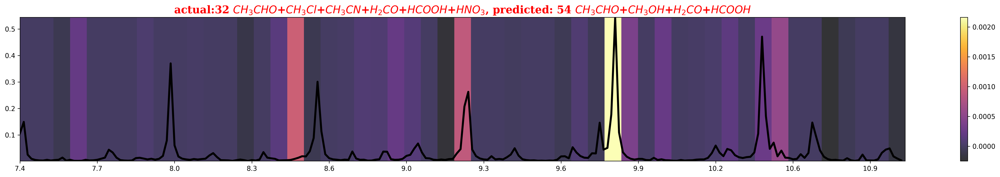

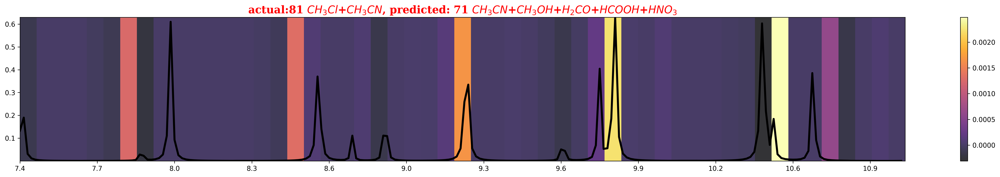

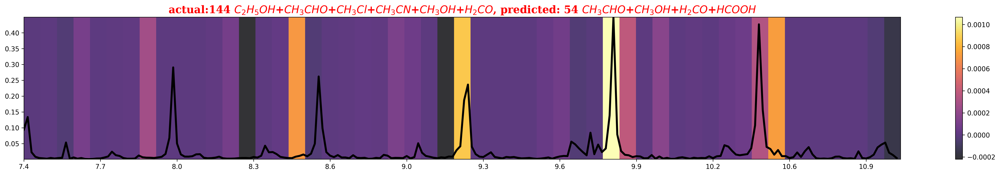

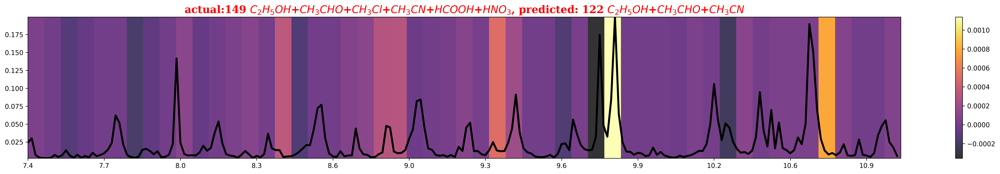

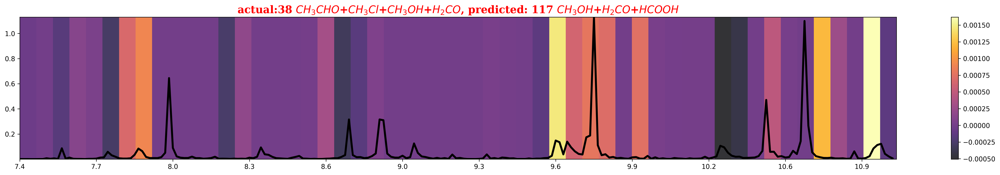

...

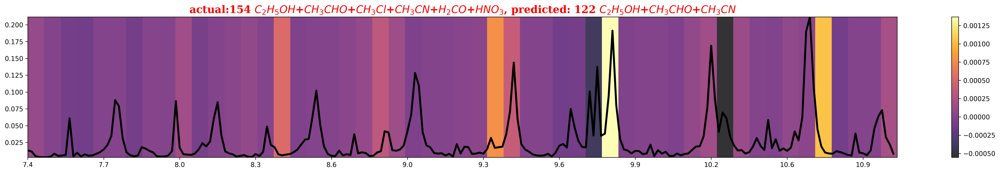

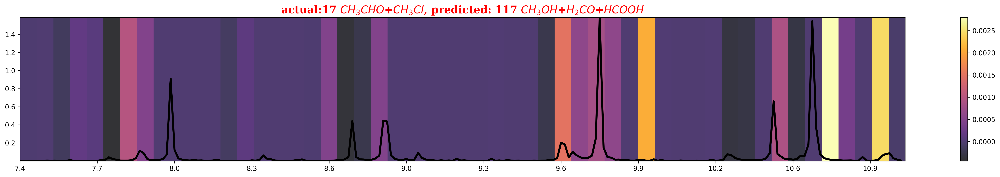

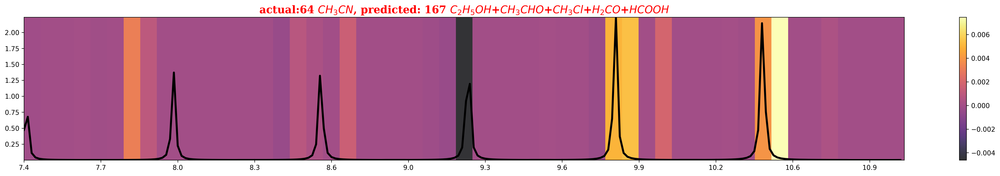

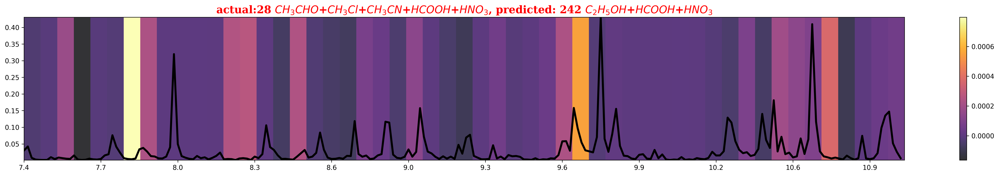

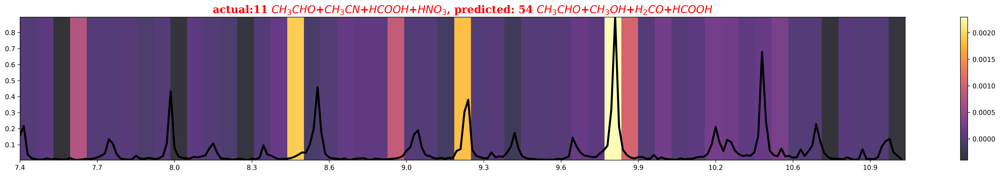

In [14]:
layer_name = 'C5'
#calculate max heatmap value to normalize the plots
max_heat_map_vals=[]
min_heat_map_vals=[]
for i in x_val:
    
    data = np.expand_dims(i,0)
    heatmap = grad_cam(layer_name,data, model)
    max_heat_map_vals.append(np.max(heatmap))
    min_heat_map_vals.append(np.min(heatmap))

print(f'layer {layer_name} class activation maps')

font = {'family': 'serif',
        'color':  'black',
        'weight': 'bold',
        'size': 16,
        }

# freq_GHz = 29.9792458*m.frequencies
freq_GHz = m.frequencies

count = 0





for i,j,k in zip(x_val,y_val,pred_y):
    
    data = np.expand_dims(i,0)
    heatmap = grad_cam(layer_name,data, model)
    
#     norm_heat_map = (heatmap-min(min_heat_map_vals))/(max(max_heat_map_vals)-min(min_heat_map_vals)) #normalize globally
    
#     norm_heat_map = (heatmap-np.min(heatmap))//(np.max(heatmap)-np.min(heatmap)) # normalzie individual heatmaps
    
    #normalized map
#     fig = plt.figure(figsize=(30,4),dpi=300)
#     plt.imshow(np.expand_dims(norm_heat_map,axis=2), aspect="auto", cmap='inferno_r', interpolation='nearest',extent=[0,229,i.min(),i.max()], alpha=0.8)
    
#     ticklist = range(0,229)
#     plt.xticks(ticklist[::30], np.round(m.frequencies.tolist()[::30], decimals=1) ) # tick every 40th frequency
#     plt.xticks(ticklist[::20], np.round(freq_GHz[::20], decimals=1) ) # tick every 40th frequency
#     plt.plot(i,'k',linewidth=3)
    
#     if mixture_types[j] != mixture_types[k]:
#         plt.title(f'actual:{mixture_types[j]}, predicted:{mixture_types[k]}', color='red', fontdict=font)
#     else:
#         plt.title(f'actual:{mixture_types[j]}, predicted:{mixture_types[k]}', color='black', fontdict=font)
#     plt.colorbar()
# #     plt.clim(np.min(norm_heat_map),np.max(norm_heat_map))
#     plt.clim(0,1)
#     print(np.min(norm_heat_map))
#     print(np.max(norm_heat_map))
#     plt.show()
    
    
    # raw map
    fig = plt.figure(figsize=(30,4),dpi=300)
    plt.imshow(np.expand_dims(heatmap,axis=2),cmap='inferno', aspect="auto", interpolation='nearest',extent=[0,229,i.min(),i.max()], alpha=0.8)
    
    ticklist = range(0,229)
#     plt.xticks(ticklist[::30], np.round(m.frequencies.tolist()[::30], decimals=1) ) # tick every 40th frequency
    plt.xticks(ticklist[::20], np.round(freq_GHz[::20], decimals=1) ) # tick every 40th frequency
    plt.plot(i,'k',linewidth=3)
    
    if mixture_types[j] != mixture_types[k]:
        plt.title(f'actual:{j} {mixture_types[j]}, predicted: {k} {mixture_types[k]}', color='red', fontdict=font)
    else:
        plt.title(f'actual: {j} {mixture_types[j]}, predicted: {k} {mixture_types[k]}', color='black', fontdict=font)
    plt.colorbar()
    plt.clim(np.min(heatmap),np.max(heatmap))
    plt.show()
    
    
#     fig.savefig(r'RESULTS/grad_cam_multi_class/CAM_C5_val' + str(count) + '.png', bbox_inches='tight')
    count = count + 1
    
    if count ==50:
        break
        
        